# <font color='red'> Spoken Digit Recognition</font>

<pre>
In this notebook, You will do Spoken Digit Recognition. 

Input - speech signal, output - digit number



It contains  

1. Reading the dataset. and Preprocess the data set. Detailed instrctions are given below. You have to write the code in the same cell which contains the instrction. 
2. Training the LSTM with RAW data
3. Converting to spectrogram and Training the LSTM network
4. Creating the augmented data and doing step 2 and 3 again.  

<font size=5>Instructions:</font>

    1. Don't change any Grader Functions. Don't manipulate any Grader functions. If you manipulate any, it will be considered as plagiarised. 
    
    2. Please read the instructions on the code cells and markdown cells. We will explain what to write. 
    
    3. Please return outputs in the same format what we asked. Eg. Don't return List of we are asking for a numpy array.
    
    4. Please read the external links that we are given so that you will learn the concept behind the code that you are writing.
    
    5. We are giving instructions at each section if necessary, please follow them. 

<font size=5>Every Grader function has to return True. </font>

</pre>

In [1]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"devilkar","key":"a2a33b5546abd8ee8ed097013e8fe26c"}'}

In [2]:
!mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d devilkar/speechrecogonition

 56% 5.00M/8.93M [00:00<00:00, 48.7MB/s]
100% 8.93M/8.93M [00:00<00:00, 57.3MB/s]


In [3]:
import numpy as np
import pandas as pd
import librosa
import os
import zipfile
import datetime
##if you need any imports you can do that here. 

We shared recordings.zip, please unzip those. 

In [4]:
base_path = "/content/speechrecogonition.zip"
speech_data = zipfile.ZipFile(base_path,'r')
#Mention the file Name
speech_data.extractall("Speech_recorded_data")
speech_data.close()

In [5]:
#read the all file names in the recordings folder given by us
#(if you get entire path, it is very useful in future)
#save those files names as list in "all_files"
path = "/content/Speech_recorded_data"
print(os.listdir(path))

['recordings']


In [6]:
recording_path = os.path.join(path,'recordings')
print("Total No of Audio file : {0}".format(len(os.listdir(recording_path))))


Total No of Audio file : 2000


In [7]:
recording_path

'/content/Speech_recorded_data/recordings'

In [8]:
print(os.listdir(recording_path)[10].split("_"))

['7', 'yweweler', '35.wav']


In [9]:
all_files = []
for path in os.listdir(recording_path):
    all_files.append(recording_path + "/"+path)

<font size=4>Grader function 1 </font>

In [10]:
def grader_files():
    temp = len(all_files)==2000
    temp1 = all([x[-3:]=="wav" for x in all_files])
    temp = temp and temp1
    return temp
grader_files()

True

Create a dataframe(name=df_audio) with two columns(path, label).   
You can get the label from the first letter of name.  
Eg: 0_jackson_0 --> 0  
0_jackson_43 --> 0

## Exploring the sound dataset

In [11]:
!git clone https://github.com/AllenDowney/ThinkDSP.git 

Cloning into 'ThinkDSP'...
remote: Enumerating objects: 2421, done.
remote: Total 2421 (delta 0), reused 0 (delta 0), pack-reused 2421
Receiving objects: 100% (2421/2421), 207.80 MiB | 6.92 MiB/s, done.
Resolving deltas: 100% (1320/1320), done.


In [12]:
#It is a good programming practise to explore the dataset that you are dealing with. This dataset is unique in itself because it has sounds as input
#https://colab.research.google.com/github/Tyler-Hilbert/AudioProcessingInPythonWorkshop/blob/master/AudioProcessingInPython.ipynb
#visualize the data and write code to play 2-3 sound samples in the notebook for better understanding.
#please go through the following reference video https://www.youtube.com/watch?v=37zCgCdV468

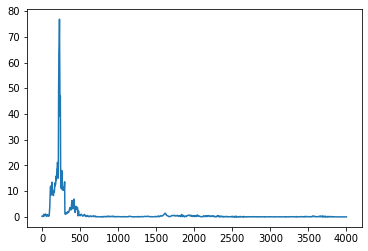

Writing sound.wav


In [13]:
import sys
sys.path.insert(0, 'ThinkDSP/code/') 
import thinkdsp
import matplotlib.pyplot as pyplot
import IPython

# Read in audio file
wave = thinkdsp.read_wave(all_files[90])

# Grab first 10 seconds of audio (you can ignore me)
clipLength = 20 # in seconds
index = 0
while (index < wave.ts.size and wave.ts[index] < clipLength):
	index += 1
# Remove extras
wave.ts = wave.ts[:index]
wave.ys = wave.ys[:index]


# Filter
spectrum = wave.make_spectrum()
spectrum.low_pass(cutoff = 300, factor = .1)
#spectrum.high_pass(cutoff = 1500, factor = .1) # FIXME - Change back to low pass filter
filteredWave = spectrum.make_wave()

# Plot spectrum of audio file
spectrum = filteredWave.make_spectrum()
spectrum.plot()
pyplot.show()

# Play filtered audio file
filteredWave.play()
IPython.display.Audio('sound.wav')

## Creating dataframe

In [10]:
#Create a dataframe(name=df_audio) with two columns(path, label).   
#You can get the label from the first letter of name.  
#Eg: 0_jackson_0 --> 0  
#0_jackson_43 --> 0
audio_labels = [float(audio_file.split("_")[0]) for audio_file in os.listdir(recording_path)] 
df_audio = pd.DataFrame({"path" : all_files,"label":audio_labels})

In [11]:
#info
df_audio.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   path    2000 non-null   object 
 1   label   2000 non-null   float64
dtypes: float64(1), object(1)
memory usage: 31.4+ KB


<font size=4>Grader function 2 </font>

In [12]:
def grader_df():
    flag_shape = df_audio.shape==(2000,2)
    flag_columns = all(df_audio.columns==['path', 'label'])
    list_values = list(df_audio.label.value_counts())
    flag_label = len(list_values)==10
    flag_label2 = all([i==200 for i in list_values])
    final_flag = flag_shape and flag_columns and flag_label and flag_label2
    return final_flag
grader_df()

True

In [13]:
from sklearn.utils import shuffle
df_audio = shuffle(df_audio, random_state=33)#don't change the random state

<pre><font size=4>Train and Validation split</font></pre>

In [14]:
#split the data into train and validation and save in X_train, X_test, y_train, y_test
from sklearn.model_selection import  train_test_split

X = df_audio['path']
y = df_audio['label']
X_train, X_test, y_train,y_test = train_test_split(X,y,stratify = y,test_size = 0.3, random_state = 45)
#use stratify sampling
#use random state of 45
#use test size of 30%


<font size=4>Grader function 3 </font>

In [15]:
def grader_split():
    flag_len = (len(X_train)==1400) and (len(X_test)==600) and (len(y_train)==1400) and (len(y_test)==600)
    values_ytrain = list(y_train.value_counts())
    flag_ytrain = (len(values_ytrain)==10) and (all([i==140 for i in values_ytrain]))
    values_ytest = list(y_test.value_counts())
    flag_ytest = (len(values_ytest)==10) and (all([i==60 for i in values_ytest]))
    final_flag = flag_len and flag_ytrain and flag_ytest
    return final_flag
grader_split()

True

<pre><font size=4>Preprocessing</font>

All files are in the "WAV" format. We will read those raw data files using the librosa</pre>

In [16]:
sample_rate = 22050
def load_wav(x, get_duration=True):
    '''This return the array values of audio with sampling rate of 22050 and Duration'''
    #loading the wav file with sampling rate of 22050
    samples, sample_rate = librosa.load(x, sr=22050)
    if get_duration:
        duration = librosa.get_duration(samples, sample_rate)
        return [samples, duration]
    else:
        return samples

In [17]:
X_train_processed = []
X_test_processed = []

In [18]:
#use load_wav function that was written above to get every wave. 
#save it in X_train_processed and X_test_processed
def preprocess_audio_data(audio_files):
    raw_files,duration_list = [],[]
    for idx,audio_file in enumerate(audio_files):
        samples,duration = load_wav(audio_file)
        raw_files.append(samples)
        duration_list.append(duration)
    preprocessed_dataframe = pd.DataFrame({"raw_data" : raw_files,'duration' : duration_list})
    return preprocessed_dataframe

X_train_processed,X_test_processed = preprocess_audio_data(X_train.values),preprocess_audio_data(X_test.values) 
    
#X_train_processed, X_test_processed = load_wav(X_train.values), load_wav(X_test.values)
# X_train_processed/X_test_processed should be dataframes with two columns(raw_data, duration) with same index of X_train/y_train


In [19]:
X_train_processed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1400 entries, 0 to 1399
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   raw_data  1400 non-null   object 
 1   duration  1400 non-null   float64
dtypes: float64(1), object(1)
memory usage: 22.0+ KB


In [24]:
X_train_processed.head(10)

,raw_data,duration
0,"[-0.00050216826, 2.7594652e-07, 0.00022539018,...",0.459138
1,"[-0.0008239056, -0.00075821934, -0.0005198983,...",0.257143
2,"[0.0016795197, -6.503213e-05, -0.005055008, -0...",0.230385
3,"[-0.009725378, -0.011341786, -0.011049435, -0....",0.395420
4,"[0.0005111587, 0.0006119106, 0.0006307227, 0.0...",0.387029
5,"[-0.0005348968, 0.00029281023, 0.001044386, 0....",0.338912
6,"[4.4097458e-05, 5.474639e-05, 3.8307837e-05, 9...",0.405397
7,"[-0.00019068005, -0.00024691445, -0.0002540210...",0.241542
8,"[-0.0069812275, -0.007846648, -0.008209535, -0...",0.402132
9,"[1.7610597e-05, -8.146022e-05, -0.00022273406,...",0.378639


In [20]:
X_test_processed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600 entries, 0 to 599
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   raw_data  600 non-null    object 
 1   duration  600 non-null    float64
dtypes: float64(1), object(1)
memory usage: 9.5+ KB


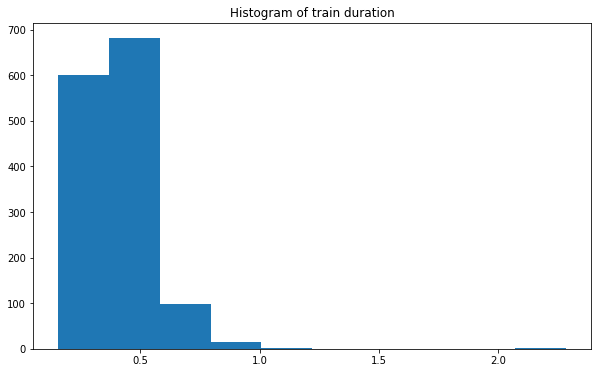

In [26]:
#plot the histogram of the duration for trian
import matplotlib.pyplot as plt
plt.figure(figsize = (10,6))
plt.hist(X_train_processed.duration.values)
plt.title("Histogram of train duration")
plt.show()

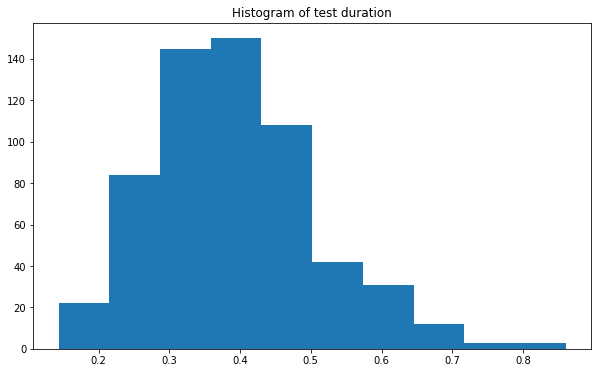

In [27]:
#plot the histogram of the duration for trian
plt.figure(figsize = (10,6))
plt.hist(X_test_processed.duration.values)
plt.title("Histogram of test duration")
plt.show()

In [28]:
#print 0 to 100 percentile values with step size of 10 for train data duration. 
for i in range(0,100,10):
    print("{} th percentile is {}".format(i,np.percentile(X_train_processed.duration.values,i)))

0 th percentile is 0.1564172335600907
10 th percentile is 0.26312018140589566
20 th percentile is 0.3022222222222222
30 th percentile is 0.33380952380952383
40 th percentile is 0.3618684807256236
50 th percentile is 0.391156462585034
60 th percentile is 0.41955555555555557
70 th percentile is 0.4501995464852607
80 th percentile is 0.48639455782312924
90 th percentile is 0.5621632653061226


In [29]:
#print 90th percentile to 100 th percentil 
for i in  range(90,101,1):
    print("{} th percentile is {}".format(i,np.percentile(X_train_processed.duration.values,i)))

90 th percentile is 0.5621632653061226
91 th percentile is 0.5757945578231292
92 th percentile is 0.5895238095238096
93 th percentile is 0.6080367346938776
94 th percentile is 0.6200163265306122
95 th percentile is 0.6355306122448978
96 th percentile is 0.6466866213151926
97 th percentile is 0.6652689342403627
98 th percentile is 0.7149841269841267
99 th percentile is 0.8209596371882085
100 th percentile is 2.282766439909297


<font size=4>Grader function 4 </font>

In [30]:
def grader_processed():
    flag_columns = (all(X_train_processed.columns==['raw_data', 'duration'])) and (all(X_test_processed.columns==['raw_data', 'duration']))
    flag_shape = (X_train_processed.shape ==(1400, 2)) and (X_test_processed.shape==(600,2))
    return flag_columns and flag_shape
grader_processed()

True

<pre>Based on our analysis 99 percentile values are less than 0.8sec so we will limit maximum length of X_train_processed and X_test_processed to 0.8 sec. It is similar to pad_sequence for a text dataset. 

While loading the audio files, we are using sampling rate of 22050 so one sec will give array of length 22050. so, our maximum length is 0.8*22050 = 17640

Pad with Zero if length of sequence is less than 17640 else Truncate the number. 

Also create a masking vector for train and test. 

masking vector value = 1 if it is real value, 0 if it is pad value. Masking vector data type must be bool.
</pre>

In [31]:
max_length  = 17640

In [21]:
#https://www.tensorflow.org/guide/keras/masking_and_padding
#https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/sequence/pad_sequences
from tensorflow.keras.preprocessing.sequence import pad_sequences

max_length = 17640
## as discussed above, Pad with Zero if length of sequence is less than 17640 else Truncate the number. 
## save in the X_train_pad_seq, X_test_pad_seq
X_train_pad_seq = pad_sequences(X_train_processed['raw_data'],maxlen = max_length, dtype = 'float32',padding= 'post')
X_test_pad_seq = pad_sequences(X_test_processed['raw_data'],maxlen = max_length, dtype='float32',padding=  'post')




In [33]:
(X_train_pad_seq != 0.0)

array([[ True,  True,  True, ..., False, False, False],
       [ True,  True,  True, ..., False, False, False],
       [ True,  True,  True, ..., False, False, False],
       ...,
       [ True,  True,  True, ..., False, False, False],
       [ True,  True,  True, ..., False, False, False],
       [ True,  True,  True, ..., False, False, False]])

In [22]:
## as discussed above, Pad with Zero if length of sequence is less than 17640 else Truncate the number. 
## save in the X_train_pad_seq, X_test_pad_seq
## also Create masking vector X_train_mask, X_test_mask
X_train_mask,X_test_mask = (X_train_pad_seq != 0.0),(X_test_pad_seq != 0.0)
## all the X_train_pad_seq, X_test_pad_seq, X_train_mask, X_test_mask will be numpy arrays mask vector dtype must be bool.

In [23]:
type(X_train_mask[0][0])

numpy.bool_

<font size=4>Grader function 5 </font>

In [36]:
def grader_padoutput():
    flag_padshape = (X_train_pad_seq.shape==(1400, 17640)) and (X_test_pad_seq.shape==(600, 17640)) and (y_train.shape==(1400,))
    flag_maskshape = (X_train_mask.shape==(1400, 17640)) and (X_test_mask.shape==(600, 17640)) and (y_test.shape==(600,))
    flag_dtype = (X_train_mask.dtype==bool) and (X_test_mask.dtype==bool)
    return flag_padshape and flag_maskshape and flag_dtype
grader_padoutput()

True

### 1. Giving Raw data directly. 

In [24]:
import tensorflow as tf

In [38]:
X_train_mask.shape

(1400, 17640)

In [39]:
input = tf.keras.layers.Input(shape=(X_train_pad_seq.shape[1],1))
mask_input = tf.keras.layers.Input(shape=(X_train_mask.shape[1]),dtype='bool')
lstm_layer = tf.keras.layers.LSTM(32)
lstm_output = lstm_layer(input,mask = mask_input)
dense = tf.keras.layers.Dense(16,activation='relu')(lstm_output)
output = tf.keras.layers.Dense(10,activation = 'softmax')(dense)
model_2 = tf.keras.models.Model(inputs = [input ,mask_input], outputs = output)

In [40]:
model_2.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 17640, 1)]   0           []                               
                                                                                                  
 input_2 (InputLayer)           [(None, 17640)]      0           []                               
                                                                                                  
 lstm (LSTM)                    (None, 32)           4352        ['input_1[0][0]',                
                                                                  'input_2[0][0]']                
                                                                                                  
 dense (Dense)                  (None, 16)           528         ['lstm[0][0]']               

In [25]:
from sklearn.metrics import f1_score
class F1Metrics(tf.keras.callbacks.Callback):

    def __init__(self,validation_data):

        super(F1Metrics,self).__init__()
        self.validation_data = validation_data


    def on_epoch_end(self,epochs,logs = {}):

        y_true = self.validation_data[1]
        y_pred = self.model.predict(self.validation_data[0])
        y_pred = np.argmax(y_pred,axis = 1
                           )
        f1_score_metrics = f1_score(y_true,y_pred,average='micro') 

        logs['val_f1_score'] = f1_score_metrics

        print("f1 Score  : {0}".format(f1_score_metrics))


In [42]:
#lstm input dimention is -> number_of_batches,time_stamps,Features
X_train_input = [ np.expand_dims(X_train_pad_seq,axis =2),X_train_mask]
X_test_input = [np.expand_dims(X_test_pad_seq,axis = 2),X_test_mask]

In [ ]:
import datetime
#https://stackoverflow.com/questions/44583254/valueerror-input-0-is-incompatible-with-layer-lstm-13-expected-ndim-3-found-n
f1_score_callback = F1Metrics((X_test_input,y_test))
early_stopping_call_backs = tf.keras.callbacks.EarlyStopping(patience= 2)
log_dir= log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(
                            log_dir=log_dir, histogram_freq=1)
call_backs = [f1_score_callback,early_stopping_call_backs,tensorboard_callback]

model_2.compile(optimizer= tf.keras.optimizers.Adam( learning_rate=0.001),loss = tf.keras.losses.SparseCategoricalCrossentropy(),metrics = ['accuracy']
              )
model_history = model_2.fit(X_train_input,y_train,epochs = 5,validation_data=(X_test_input,y_test),batch_size = 32,callbacks =call_backs)




Epoch 1/5
44/44 [==============================] - 77s 2s/step - loss: 2.3033 - accuracy: 0.0957 - val_loss: 2.3027 - val_accuracy: 0.0933
f1 Score  : 0.09333333333333334
Epoch 2/5
44/44 [==============================] - 64s 1s/step - loss: 2.3030 - accuracy: 0.0864 - val_loss: 2.3026 - val_accuracy: 0.0983
f1 Score  : 0.09833333333333333
Epoch 3/5
44/44 [==============================] - 72s 2s/step - loss: 2.3028 - accuracy: 0.0864 - val_loss: 2.3026 - val_accuracy: 0.1000
f1 Score  : 0.10000000000000002
Epoch 4/5
44/44 [==============================] - 71s 2s/step - loss: 2.3028 - accuracy: 0.0957 - val_loss: 2.3026 - val_accuracy: 0.1033
f1 Score  : 0.10333333333333333
Epoch 5/5
44/44 [==============================] - 72s 2s/step - loss: 2.3027 - accuracy: 0.0936 - val_loss: 2.3026 - val_accuracy: 0.1000
f1 Score  : 0.10000000000000002


In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/logs/fit/20211109-123458'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Model-1 Accuracy,Loss and F1Score 

<img src='https://imgur.com/xn2ZA3D.jpg'>

<img src = 'https://imgur.com/ojs3h0T.jpg'>

<img src = 'https://imgur.com/W0E26Ta.jpg'>

<pre>
Now we have

Train data: X_train_pad_seq, X_train_mask and y_train  
Test data: X_test_pad_seq, X_test_mask and y_test   

We will create a LSTM model which takes this input. 

Task:

1. Create an LSTM network which takes "X_train_pad_seq" as input, "X_train_mask" as mask input. You can use any number of LSTM cells. Please read LSTM documentation(https://www.tensorflow.org/api_docs/python/tf/keras/layers/LSTM) in tensorflow to know more about mask and also https://www.tensorflow.org/guide/keras/masking_and_padding 
2. Get the final output of the LSTM and give it to Dense layer of any size and then give it to Dense layer of size 10(because we have 10 outputs) and then compile with the sparse categorical cross entropy( because we are not converting it to one hot vectors). Also check the datatype of class labels(y_values) and make sure that you convert your class labels  to integer datatype before fitting in the model.
3. While defining your model make sure that you pass both the input layer and mask input layer as input to lstm layer as follows
<img src='https://i.imgur.com/FvcgvbY.jpg'>
4. Use tensorboard to plot the graphs of loss and metric(use custom micro F1 score as metric) and histograms of gradients. You can write your code for computing F1 score using this <a  href='https://i.imgur.com/8YULUcu.jpg'>link</a> 

5. make sure that it won't overfit. 
6. You are free to include any regularization
</pre>

In [ ]:
## as discussed above, please write the architecture of the model.
## you will have two input layers in your model (data input layer and mask input layer)
## make sure that you have defined the data type of masking layer as bool


In [ ]:
#train your model
#model1.fit([X_train_pad_seq,X_train_mask],y_train_int,.........)

### 2. Converting into spectrogram and giving spectrogram data as input  
<pre>
We can use librosa to convert raw data into spectrogram. A spectrogram shows the features in a two-dimensional representation with the
intensity of a frequency at a point in time i.e we are converting Time domain to frequency domain. you can read more about this in https://pnsn.org/spectrograms/what-is-a-spectrogram
</pre>

In [26]:
def convert_to_spectrogram(raw_data):
    '''converting to spectrogram'''
    spectrum = librosa.feature.melspectrogram(y=raw_data, sr=sample_rate, n_mels=64)
    logmel_spectrum = librosa.power_to_db(S=spectrum, ref=np.max)
    return logmel_spectrum

In [28]:
convert_to_spectrogram(X_train_pad_seq[0])

array([[-54.270134, -52.505615, -51.841507, ..., -80.      , -80.      ,
        -80.      ],
       [-51.343956, -50.148666, -49.257126, ..., -80.      , -80.      ,
        -80.      ],
       [-51.26763 , -52.10228 , -51.384697, ..., -80.      , -80.      ,
        -80.      ],
       ...,
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ],
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ],
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ]], dtype=float32)

In [29]:
##use convert_to_spectrogram and convert every raw sequence in X_train_pad_seq and X_test_pad-seq.
## save those all in the X_train_spectrogram and X_test_spectrogram ( These two arrays must be numpy arrays)

def convert_padding_to_spectogram(padding_data):
    spectrogram_list = []
    for padded_sequence in padding_data:
        spectrogram_list.append(convert_to_spectrogram(padded_sequence))
    return np.array(spectrogram_list)


In [30]:
X_train_spectrogram = convert_padding_to_spectogram(X_train_pad_seq)
X_test_spectrogram = convert_padding_to_spectogram(X_test_pad_seq)

In [31]:
X_train_spectrogram.shape

(1400, 64, 35)

<font size=4>Grader function 6 </font>

In [48]:
def grader_spectrogram():
    flag_shape = (X_train_spectrogram.shape==(1400,64, 35)) and (X_test_spectrogram.shape == (600, 64, 35))
    return flag_shape
grader_spectrogram()

True

<pre>
Now we have

Train data: X_train_spectrogram and y_train  
Test data: X_test_spectrogram and y_test   

We will create a LSTM model which takes this input. 

Task:

1. Create an LSTM network which takes "X_train_spectrogram" as input and has to return output at every time step. 
2. Average the output of every time step and give this to the Dense layer of any size. 
(ex: Output from LSTM will be  (None, time_steps, features) average the output of every time step i.e, you should get (None,time_steps) 
and then pass to dense layer )
3. give the above output to Dense layer of size 10( output layer) and train the network with sparse categorical cross entropy.  
4. Use tensorboard to plot the graphs of loss and metric(use custom micro F1 score as metric) and histograms of gradients. You can write your code for computing F1 score using this <a  href='https://i.imgur.com/8YULUcu.jpg'>link</a> 
5. make sure that it won't overfit. 
6. You are free to include any regularization
</pre>

In [32]:
# write the architecture of the model
tf.keras.backend.clear_session()
input_spectrum = tf.keras.layers.Input(shape=(X_train_spectrogram.shape[1],X_train_spectrogram.shape[2]))
lstm_layer = tf.keras.layers.LSTM(units = 64, return_sequences= True)(input_spectrum)
lstm_layer = tf.keras.layers.LSTM(units = 64, return_sequences= True)(lstm_layer)
global_average_pooling = tf.keras.layers.GlobalAvgPool1D()(lstm_layer)
dense_layer = tf.keras.layers.Dense(units = 64, activation = 'relu')(global_average_pooling)
dense_layer = tf.keras.layers.Dense(units = 32 , activation = 'relu')(dense_layer)
output_layer = tf.keras.layers.Dense(units= 10,activation = 'softmax')(dense_layer)
model_3 = tf.keras.models.Model(inputs = input_spectrum,outputs= output_layer)
model_3.summary()
#print model.summary and make sure that it is following point 2 mentioned above

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 35)]          0         
                                                                 
 lstm (LSTM)                 (None, 64, 64)            25600     
                                                                 
 lstm_1 (LSTM)               (None, 64, 64)            33024     
                                                                 
 global_average_pooling1d (G  (None, 64)               0         
 lobalAveragePooling1D)                                          
                                                                 
 dense (Dense)               (None, 64)                4160      
                                                                 
 dense_1 (Dense)             (None, 32)                2080      
                                                             

In [34]:
import datetime
#compile and fit your model.
#model2.fit([X_train_spectrogram],y_train_int,......)
f1_score_callback = F1Metrics((X_test_spectrogram,y_test))
#early_stopping_call_backs = tf.keras.callbacks.EarlyStopping(patience= 2)
log_dir= log_dir = "logs/fit/model_2" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(
                            log_dir=log_dir, histogram_freq=1)
call_backs = [f1_score_callback,tensorboard_callback]

model_3.compile(optimizer= tf.keras.optimizers.Adam( learning_rate=0.001),loss = tf.keras.losses.SparseCategoricalCrossentropy(),metrics = ['accuracy'])
model_history = model_3.fit(X_train_spectrogram,y_train,epochs = 100,validation_data=(X_test_spectrogram,y_test),batch_size = 32,callbacks =call_backs)






Epoch 1/100
44/44 [==============================] - 13s 100ms/step - loss: 2.1542 - accuracy: 0.1807 - val_loss: 1.9882 - val_accuracy: 0.2167 - val_f1_score: 0.2167
Epoch 2/100
44/44 [==============================] - 2s 45ms/step - loss: 1.8900 - accuracy: 0.2579 - val_loss: 1.8489 - val_accuracy: 0.3800 - val_f1_score: 0.3800
Epoch 3/100
44/44 [==============================] - 2s 49ms/step - loss: 1.7052 - accuracy: 0.3886 - val_loss: 1.7534 - val_accuracy: 0.3633 - val_f1_score: 0.3633
Epoch 4/100
44/44 [==============================] - 2s 45ms/step - loss: 1.5874 - accuracy: 0.4186 - val_loss: 1.5704 - val_accuracy: 0.4200 - val_f1_score: 0.4200
Epoch 5/100
44/44 [==============================] - 2s 44ms/step - loss: 1.4937 - accuracy: 0.4529 - val_loss: 1.5191 - val_accuracy: 0.4683 - val_f1_score: 0.4683
Epoch 6/100
44/44 [==============================] - 2s 47ms/step - loss: 1.4028 - accuracy: 0.5064 - val_loss: 1.4113 - val_accuracy: 0.5167 - val_f1_score: 0.5167
Epoch 7/

In [37]:
%load_ext tensorboard
%tensorboard --logdir "/content/logs/fit/model_220211110-103337"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Model-2 Accuracy,F1Score and Loss
<img src = 'https://imgur.com/zQabwVg.jpg'>
<img src = 'https://imgur.com/cESzkk5.jpg'>
<img src = 'https://imgur.com/MUaO1FD.jpg'>

### 3. Data augmentation with raw features 
<pre>
Till now we have done with 2000 samples only. It is very less data. We are giving the process of generating augmented data below.

There are two types of augmentation:
1. time stretching - Time stretching either increases or decreases the length of the file. For time stretching we move the file 30% faster or slower
2. pitch shifting - pitch shifting moves the frequencies higher or lower. For pitch shifting we shift up or down one half-step.
</pre>

In [50]:
## generating augmented data. 
def generate_augmented_data(file_path):
    augmented_data = []
    samples = load_wav(file_path,get_duration=False)
    for time_value in [0.7, 1, 1.3]:
        for pitch_value in [-1, 0, 1]:
            time_stretch_data = librosa.effects.time_stretch(samples, rate=time_value)
            final_data = librosa.effects.pitch_shift(time_stretch_data, sr=sample_rate, n_steps=pitch_value)
            augmented_data.append(final_data)
    return augmented_data

In [51]:
temp_path = df_audio.iloc[0].path
aug_temp = generate_augmented_data(temp_path)

In [52]:
aug_temp[0]

array([-0.01506544, -0.01777345, -0.01335487, ..., -0.00206719,
       -0.00166811, -0.00205901], dtype=float32)

In [53]:
type(aug_temp)

list

In [54]:
len(aug_temp)

9

## Follow the steps 

1. Split data 'df_audio' into train and test (80-20 split)

2. We have 2000 data points(1600 train points, 400 test points) 



In [55]:
X_train, X_test, y_train, y_test=train_test_split(df_audio['path'],df_audio['label'],random_state=45,test_size=0.2,stratify=df_audio['label'])

3. Do augmentation only on X_train,pass each point of X_train to generate_augmented_data function.After augmentation we will get 14400 train points. Make sure that you are augmenting the corresponding class labels (y_train) also.
4. Preprocess your X_test using load_wav function.
5. Convert the augmented_train_data and test_data to numpy arrays.
6. Perform padding and masking on augmented_train_data and test_data.
7. After padding define the model similar to model 1 and fit the data

<font color='red'> Note </font> - While fitting your model on the augmented data for model 3 you might face Resource exhaust error. One simple hack to avoid that is save the augmented_train_data,augment_y_train,test_data and y_test to Drive or into your local system. Then restart the runtime so that now you can train your model with full RAM capacity. Upload these files again in the new runtime session perform padding and masking and then fit your model.

In [56]:
import tqdm
def data_agumentation(audio_data,labels):

    augmented_data,genetated_labels = [],[]
    
    for data in range(len(audio_data)):
        argu_generated_data = generate_augmented_data(audio_data[data])
        augmented_data.extend(argu_generated_data)
        genetated_labels.extend([labels[data]] * len(argu_generated_data))

    return (augmented_data,genetated_labels)
    

In [57]:
X_train.to_numpy()

array(['/content/Speech_recorded_data/recordings/8_yweweler_46.wav',
       '/content/Speech_recorded_data/recordings/2_jackson_26.wav',
       '/content/Speech_recorded_data/recordings/7_yweweler_18.wav', ...,
       '/content/Speech_recorded_data/recordings/0_nicolas_12.wav',
       '/content/Speech_recorded_data/recordings/3_nicolas_11.wav',
       '/content/Speech_recorded_data/recordings/2_nicolas_38.wav'],
      dtype=object)

In [58]:
X_train,y_train = data_agumentation(X_train.to_numpy(),y_train.to_numpy())
X_train = np.array(X_train)
y_train = np.array(y_train)
print("After Agumentation dataset_length : {0}".format(len(X_train)))

After Agumentation dataset_length : 14400


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  


In [59]:
print("After Agumentation dataset_length : {0}".format(len(X_train)))
print("Shape of the agumeted Data : {}".format(X_train.shape))

After Agumentation dataset_length : 14400
Shape of the agumeted Data : (14400,)


In [65]:
X_train[0]

array([ 1.09635206e-04,  1.83896977e-04,  2.19535970e-04, ...,
        3.21143627e-04, -2.62462981e-05, -2.69002427e-04], dtype=float32)

In [ ]:
X_test_spectrogram = 

In [61]:
X_train_agumented = []
for data in X_train:
    X_train_agumented.append(data[0])

In [67]:
X_test_processed = preprocess_audio_data(X_test.values)

In [69]:
#https://www.tensorflow.org/guide/keras/masking_and_padding
#https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/sequence/pad_sequences
from tensorflow.keras.preprocessing.sequence import pad_sequences

max_length = 17640
## as discussed above, Pad with Zero if length of sequence is less than 17640 else Truncate the number. 
## save in the X_train_pad_seq, X_test_pad_seq
X_train_pad_seq = pad_sequences(X_train,maxlen = max_length, dtype = 'float32',padding= 'post')
X_test_pad_seq = pad_sequences(X_test_processed['raw_data'].to_numpy(),maxlen = max_length, dtype='float32',padding=  'post')
X_train_mask,X_test_mask = (X_train_pad_seq != 0.0),(X_test_pad_seq != 0.0)

In [70]:
print("Shape of X_train Pad Sequence : {0}".format(X_train_pad_seq.shape))

Shape of X_train Pad Sequence : (14400, 17640)


In [71]:
import datetime
input = tf.keras.layers.Input(shape=(X_train_pad_seq.shape[1],1))
mask_input = tf.keras.layers.Input(shape=(X_train_mask.shape[1]),dtype='bool')
lstm_layer = tf.keras.layers.LSTM(32)
lstm_output = lstm_layer(input,mask = mask_input)
dense = tf.keras.layers.Dense(16,activation='relu')(lstm_output)
output = tf.keras.layers.Dense(10,activation = 'softmax')(dense)
model_3 = tf.keras.models.Model(inputs = [input ,mask_input], outputs = output)

#lstm input dimention is -> number_of_batches,time_stamps,Features
X_train_input = [ np.expand_dims(X_train_pad_seq,axis =2),X_train_mask]
X_test_input = [np.expand_dims(X_test_pad_seq,axis = 2),X_test_mask]


#https://stackoverflow.com/questions/44583254/valueerror-input-0-is-incompatible-with-layer-lstm-13-expected-ndim-3-found-n
f1_score_callback = F1Metrics((X_test_input,y_test))
early_stopping_call_backs = tf.keras.callbacks.EarlyStopping(patience= 2)
log_dir= log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(
                            log_dir=log_dir, histogram_freq=1)
call_backs = [f1_score_callback,early_stopping_call_backs,tensorboard_callback]

model_3.compile(optimizer= tf.keras.optimizers.Adam( learning_rate=0.001),loss = tf.keras.losses.SparseCategoricalCrossentropy(),metrics = ['accuracy']
              )
model_history = model_3.fit(X_train_input,y_train,epochs = 5,validation_data=(X_test_input,y_test),batch_size = 32,callbacks =call_backs)



#https://stackoverflow.com/questions/62839033/input-y-of-equal-op-has-type-bool-that-does-not-match-type-float32-of-argume

Epoch 1/5
450/450 [==============================] - 625s 1s/step - loss: 2.3029 - accuracy: 0.0931 - val_loss: 2.3026 - val_accuracy: 0.1000 - val_f1_score: 0.1000
Epoch 2/5
450/450 [==============================] - 617s 1s/step - loss: 2.3028 - accuracy: 0.0963 - val_loss: 2.3026 - val_accuracy: 0.1000 - val_f1_score: 0.1000
Epoch 3/5
450/450 [==============================] - 614s 1s/step - loss: 2.3028 - accuracy: 0.0956 - val_loss: 2.3026 - val_accuracy: 0.1000 - val_f1_score: 0.1000
Epoch 4/5
450/450 [==============================] - 614s 1s/step - loss: 2.3028 - accuracy: 0.0963 - val_loss: 2.3026 - val_accuracy: 0.1000 - val_f1_score: 0.1000
Epoch 5/5
450/450 [==============================] - 620s 1s/step - loss: 2.3028 - accuracy: 0.0940 - val_loss: 2.3026 - val_accuracy: 0.1000 - val_f1_score: 0.1000


In [72]:
%load_ext tensorboard
%tensorboard --logdir "/content/logs/fit/20211110-081359"

<IPython.core.display.Javascript object>

### Model - 3 Accuracy,Loss,F1 Score
<img src = 'https://imgur.com/sVuYVma.jpg'>
<img src ='https://imgur.com/WTPWabv.jpg'>

### 4. Data augmentation with spectogram data

1. use convert_to_spectrogram and convert the padded data from train and test data to spectogram data.
2. The shape of train data will be 14400 x 64 x 35 and shape of test_data will be 400 x 64 x35
3. Define the model similar to model 2 and fit the data

In [73]:
X_train_spectrogram = convert_padding_to_spectogram(X_train_pad_seq)
X_test_spectrogram = convert_padding_to_spectogram(X_test_pad_seq)

In [74]:
print("Shape of the X_train Spectrogram : {0}".format(X_train_spectrogram.shape))
print("Shape of the X_test Spectrogram : {0}".format(X_test_spectrogram.shape))

Shape of the X_train Spectrogram : (14400, 64, 35)
Shape of the X_test Spectrogram : (400, 64, 35)


In [77]:
# write the architecture of the model
tf.keras.backend.clear_session()
input_spectrum = tf.keras.layers.Input(shape=(X_train_spectrogram.shape[1],X_train_spectrogram.shape[2]))
lstm_layer = tf.keras.layers.LSTM(units = 64, return_sequences= True)(input_spectrum)
lstm_layer = tf.keras.layers.LSTM(units = 64, return_sequences= True)(lstm_layer)
global_average_pooling = tf.keras.layers.GlobalAvgPool1D()(lstm_layer)
dense_layer = tf.keras.layers.Dense(units = 64, activation = 'relu')(global_average_pooling)
dense_layer = tf.keras.layers.Dense(units = 32 , activation = 'relu')(dense_layer)
output_layer = tf.keras.layers.Dense(units= 10,activation = 'softmax')(dense_layer)
model_4 = tf.keras.models.Model(inputs = input_spectrum,outputs= output_layer)
model_4.summary()
#print model.summary and make sure that it is following point 2 mentioned above

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 35)]          0         
                                                                 
 lstm (LSTM)                 (None, 64, 64)            25600     
                                                                 
 lstm_1 (LSTM)               (None, 64, 64)            33024     
                                                                 
 global_average_pooling1d (G  (None, 64)               0         
 lobalAveragePooling1D)                                          
                                                                 
 dense (Dense)               (None, 64)                4160      
                                                                 
 dense_1 (Dense)             (None, 32)                2080      
                                                             

In [78]:
#compile and fit your model.
#model2.fit([X_train_spectrogram],y_train_int,......)
f1_score_callback = F1Metrics((X_test_spectrogram,y_test))
#early_stopping_call_backs = tf.keras.callbacks.EarlyStopping(patience= 2)
log_dir= log_dir = "logs/fit/model_4" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(
                            log_dir=log_dir, histogram_freq=1)
call_backs = [f1_score_callback,tensorboard_callback]

model_4.compile(optimizer= tf.keras.optimizers.Adam( learning_rate=0.001),loss = tf.keras.losses.SparseCategoricalCrossentropy(),metrics = ['accuracy'])
model_history = model_4.fit(X_train_spectrogram,y_train,epochs = 10,validation_data=(X_test_spectrogram,y_test),batch_size = 32,callbacks =call_backs)

Epoch 1/10
450/450 [==============================] - 22s 41ms/step - loss: 1.7619 - accuracy: 0.3344 - val_loss: 1.3490 - val_accuracy: 0.4700 - val_f1_score: 0.4700
Epoch 2/10
450/450 [==============================] - 16s 36ms/step - loss: 1.1733 - accuracy: 0.5608 - val_loss: 1.0518 - val_accuracy: 0.6150 - val_f1_score: 0.6150
Epoch 3/10
450/450 [==============================] - 17s 37ms/step - loss: 0.8378 - accuracy: 0.6851 - val_loss: 0.6744 - val_accuracy: 0.7700 - val_f1_score: 0.7700
Epoch 4/10
450/450 [==============================] - 16s 36ms/step - loss: 0.6181 - accuracy: 0.7722 - val_loss: 0.5097 - val_accuracy: 0.8200 - val_f1_score: 0.8200
Epoch 5/10
450/450 [==============================] - 16s 36ms/step - loss: 0.5157 - accuracy: 0.8145 - val_loss: 0.4229 - val_accuracy: 0.8575 - val_f1_score: 0.8575
Epoch 6/10
450/450 [==============================] - 16s 36ms/step - loss: 0.4472 - accuracy: 0.8414 - val_loss: 0.4702 - val_accuracy: 0.8300 - val_f1_score: 0.830

In [79]:
%tensorboard --logdir '/content/logs/fit/model_420211110-092309'

<IPython.core.display.Javascript object>

## Model - 4 Accuracy , F1 Score and Loss  
<img src = 'https://imgur.com/2ak2wL7.jpg'>
<img src = 'https://imgur.com/6dOggeX.jpg'>
<img src = 'https://imgur.com/NWxIEeH.jpg'>

## Conclusion 

In [4]:
from prettytable import PrettyTable
table = PrettyTable(['Model','Optimizer','Accuracy/f1_Score'])
table.add_row(['RNN','ADAM','10.002'])
table.add_row(['RNN','ADAM','92.47'])
table.add_row(['RNN','ADAM','10.00'])
table.add_row(['RNN','ADAM','92.50'])

In [5]:
print(table)

+-------+-----------+-------------------+
| Model | Optimizer | Accuracy/f1_Score |
+-------+-----------+-------------------+
|  RNN  |    ADAM   |       10.002      |
|  RNN  |    ADAM   |       92.47       |
|  RNN  |    ADAM   |       10.00       |
|  RNN  |    ADAM   |       92.50       |
+-------+-----------+-------------------+
